# Understanding the effects of PyCIGAR hyperparameters on training and results

The goal of this notebook and script is to gain intuition on the impact of the different hyperparameters currently specified to train a PPO agent in PyCIGAR.

Fixed settings in this experiment:
- PPO algorithm
- `ieee37busdata network` and load profile
- tracked device: `inverter_s701a`
- 5 discrete relative single actions
- `CentralControlPVInverterEnv` environment
- each trial is 60 epochs


Hyperparameters identified:
- discount factor $\gamma$
- GAE parameter $\lambda$
- train minibatch size
- lr (or lr schedule)
- entropy coefficient (or schedule)
- loss factors (penalties)
    - oscillation ($M$)
    - action change ($N$)
    - deviation from the initial command ($P$)


Until now, mostly qualitative results were obtained, mostly by looking at the graphs of voltage, $y$ value, injected power and actions taken by a tracked device over the course of a test simulation. In order to have objective grounds on which we can compare different solutions, we need quantitative results. Some statistics that reflect different aspects of both the solutions and the training processes are listed in the next section.

## Statistics that summarize a training

- for each epoch:
    - number of actions taken
    - average magnitude of the actions
    - total reward
    - time of earliest action
    - time of last action


An additional qualitative result is a GIF of the actions and $y$ curves over epochs. This GIF can be found in the results folder along with the full tensorboard plots.


## Methodology for this notebook

As the training can be quite long (a few hours), grids search was performed over each parameter independently. The number of epochs is fixed at 60 (~2 hours of training per trial).
The script `understand_hyperparameters.py` was used to run the trials and save the resulting metrics and plots, which are loaded and and plotted interactively in this notebook.

In [1]:
# utilities for plotting
!pip install bokeh
from bokeh.io import output_notebook
from bokeh.palettes import Dark2_6 as palette
from bokeh.models import ColumnDataSource, HoverTool
from bokeh.plotting import figure, show, gridplot
from bokeh.layouts import row, column
from IPython.display import Image
from IPython.core.display import HTML 
import matplotlib.pyplot as plt
from matplotlib.image import imread

import pickle
import itertools
import re
import time
import os
import imageio
    
output_notebook()

def plot_column(trials, column_name, hp_name, title=None):
    colors = itertools.cycle(palette)
    tools = 'box_zoom, reset, crosshair, pan, save'
    p = figure(tools=tools, plot_height=200, plot_width=600, title=title if title else column_name,
               x_axis_label='epochs')
    reg = re.compile(hp_name + "=(.*)_2020")

    for k, df in trials.items():
        hp = float(reg.findall(k)[0])
        source = ColumnDataSource(df)
        col = next(colors)
        p.line('index', column_name, source=source, alpha=1, color=col, line_width=1.5,
               legend=hp_name+'='+str(hp), muted_alpha=0.2, muted_color=col)

    p.add_tools(HoverTool(
        tooltips=[('epoch','@index'), 
                  (column_name, '@'+column_name)],
        mode='mouse'))
    p.legend.click_policy = 'mute'
    p.legend.spacing = 1
    p.legend.padding = 2
    p.legend.background_fill_alpha = 0.4
    return p
   
def plot_custom_metrics(pickle_file, hp):
    with open(pickle_file, 'rb') as f:
        res = pickle.load(f)
    
    p1 = plot_column(res, 'total_reward', hp, 'evaluation total reward')
    p2 = plot_column(res, 'episode_reward_mean', hp, 'training total reward')

    p3 = plot_column(res, 'num_actions_taken', hp, 'number of significant actions taken')
    p4 = plot_column(res, 'info/learner/default_policy/entropy', hp, 'entropy of actions (training episodes)')

    p5 = plot_column(res, 'earliest_action', hp, 'earliest action\'s timestep')
    p6 = plot_column(res, 'latest_action', hp, 'latest action\'s timestep')
    p5.y_range = p6.y_range
    
    p6.x_range = p5.x_range = p4.x_range = p3.x_range = p2.x_range = p1.x_range
    
    p = gridplot([[p1, p2], [p3, p4], [p5, p6]])
    show(p)

def get_epoch_imgs(pickle_file, hp_name, hp_value, epoch=59):
    with open(pickle_file, 'rb') as f:
        res = pickle.load(f)
    
    reg = re.compile(hp_name + "=(.*)_2020")

    for k, df in res.items():
        hp = float(reg.findall(k)[0])
        if hp == float(hp_value):
            return k + '/epoch' + str(epoch) + '-test.png'

def show_images_horizontally(list_of_files, titles=None):
    fig = plt.figure(figsize=(20 * len(list_of_files), 20))
    number_of_files = len(list_of_files)
    for i in range(number_of_files):
        a=fig.add_subplot(1,number_of_files,i+1)
        if titles:
            a.set_title(titles[i], fontsize=40)
        image = imread(list_of_files[i])
        plt.imshow(image, aspect='auto', interpolation='none')
        plt.axis('off')

Loading BokehJS ...

# Results on the reward coefficients
For these runs, as we are modifying the coefficients of the reward computation, raw values of the total reward cannot be compared. Runs with higher coefficients will naturally have a lower total reward. This is why only the convergence is of interest, with no ranking of the trials based on total reward.


## Action change penalty ($N$)

Training runs were performed with the action change penalty varying from 0 to 8.

In [2]:
plot_custom_metrics('/home/alex/hp_exp_ppo_no_expl/action_penalty.pickle', 'N')

### Reward convergence
As we can see above, **all the runs converged reward-wise**. (Reminder that here the final values cannot be compared).

### Number of actions
We may have expected a lower action penalty to lead to convergence to a higher number of significant actions taken over the course of an episode.

We observe that this is not the case, as **all of the runs converged to a number of actions of 1**.

### Time of actions
Even if there is a single action, this action could be taken at the wrong time, like at the beginning of the episode, before the hack, or long after the hack. We observe that **high values of N tend to take early actions, while lower ones tend to act around the time of the hack**. N=1 seems to learn pretty quickly to only act at the time of the hack, and is then quite stable across training epochs.

### Action distribution entropy
We note that **lower values of $N$ keep a higher entropy of the action distribution, leading to more exploration** for the first half of the training (approx 30 epochs). This is expected, and confirms that penalizing the actions of an agent leads to it being more conservative and taking less risks, as the reward it could get by exploring is compensated by the penality it would get.

### Key takeaways (action change penalty)

- does not impact reward convergence
- does not impact convergence to 1 action
- lower values tend to act around the hack time
- lower values keep the entropy higher, more exploration

## Change from initial action penalty ($P$)

Training runs were performed with the penalty varying from 0 to 8.

In [3]:
plot_custom_metrics('/home/alex/hp_exp_ppo_no_expl/init_penalty.pickle', 'P')

### Reward convergence
As before, **all the runs converge in reward**.

### Number of actions
**All the runs converge to 1 action**, but for the highest value it takes more time.

### Time of actions
We observe that low and medium values (<8) execute actions at the beginning of the episode. P=8 seems to execute its actions on time. As the penalty is applied at each timestep, a higher penalty means the agents want to wait as long as possible before taking a action away from the initial one.

### Action distribution entropy
Unexpectedly, higher values of the penalty have overall higher entropy. This is not intuitive because one may think that a high penalty would result in a low entropy distribution around the initial action. What might be happening here is that when the agent takes an action away from the initial one to get a reward, it also receives a penalty for each timestep it stays with that action: it is then attracted to the initial action, causing some "zigzags". This may explain both the higher entropy and the higher number of actions taken.

### Key takeaways (init action change penalty)

- does not impact reward convergence
- lower values act at the beginning
- a value between 4 and 8 may be optimal

## Oscillation penalty ($M$)

Training runs were performed with the oscillation penalty varying from 0 to 8.

In [4]:
plot_custom_metrics('/home/alex/hp_exp_ppo_no_expl/y_penalty.pickle', 'M')

### Reward convergence
All the runs converge in reward.

### Number of actions
**All the runs except M=0 converge to 1 action**. This makes sense for M=0: the agent takes no action to reduce its other penalties.

### Time of actions
We observe that low values (<=2) execute actions at the time of the hack, higher values tend to act immediately. Let's understand why by looking at the final curves for M=8 (left) and M=1 (right).

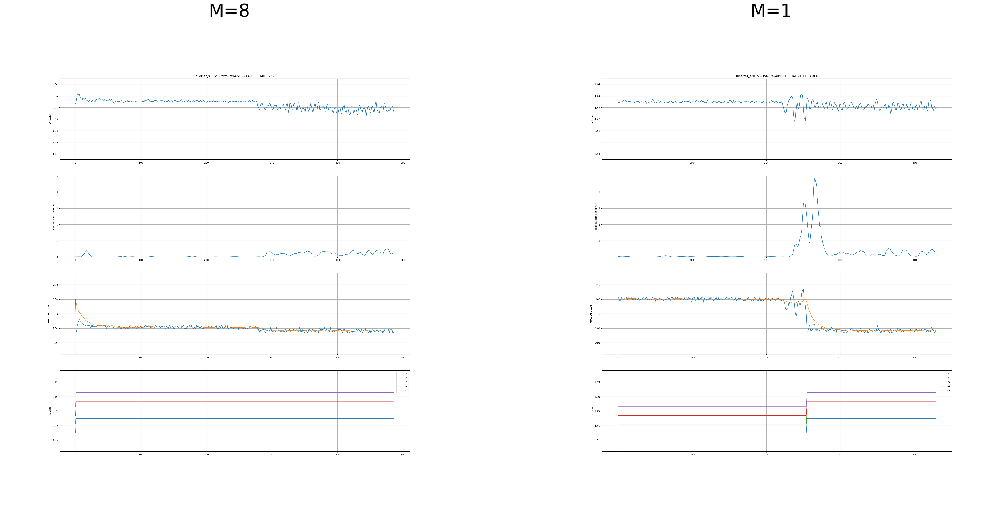

In [5]:
show_images_horizontally([get_epoch_imgs('/home/alex/hp_exp_ppo_no_expl/y_penalty.pickle', 'M', 8),
                          get_epoch_imgs('/home/alex/hp_exp_ppo_no_expl/y_penalty.pickle', 'M', 1)],
                        titles=['M=8', 'M=1'])

On the left, we see that taking an immediate action (when there is no hack yet) does not cause oscillation or a large spike in y, but still prevents some of the oscillation at the hack time.

On the right, we see a spike in y at the time of the hack (juts before the action) and another spike just after taking the action.

When the y penalty is higher (on the left), this spikes matters much more and the agent wants to avoid it. When the penality is lower, the penalty that the agent gets for going away for the initial action (P) plays a bigger role in the reward, so the agent prefers to act as late as possible, and cares less about the spike.

# Gamma (reward discount)

In [6]:
plot_custom_metrics('/home/alex/hp_exp_ppo_no_expl/gamma.pickle', 'gamma')

### Reward
We observe that except for the extreme $\gamma=1$, **all the runs converge in reward**. 0.2 converge to the best reward, both in training and in evaluation.

### Number of actions
All non-extreme values (0.2 to 0.9) seem to converge to 1 single action.

### Time of actions
$\gamma=0$ and $\gamma=0.2$ both seem to converge to taking actions at the time of the hack.

### Key takeaways (gamma)

- don't pick extreme values
- choose lower values to act at the hack time

# Lambda (TD($\lambda$) parameter)

In [7]:
plot_custom_metrics('/home/alex/hp_exp_ppo_no_expl/lambda.pickle', 'lambda')

### Reward
We observe that higher values get higher rewards than low ones.

### Number of actions
Only high values (0.9 and 1) converge to a single action.

### Time of actions
All the higher values (>=0.5) learned to act at the hack time.


### Key takeaways ($\lambda$ GAE parameter)

Picking a high value (0.9 or 1) seems to have good rewards and the desired action convergence.

# Learning rate

The learning rate is the scaling of each gradient update done by SGD.

In [8]:
plot_custom_metrics('/home/alex/hp_exp_ppo_no_expl/lr.pickle', 'lr')

### Reward
All the tested values lead to reward convergence, but the final reward seems to be higher for `lr=2e-3` and `lr=2e-4`.

### Number of actions
All the runs finally converged to 1 action, but the convergence is much faster for low values of the learning rate (`lr<=2e-4`).

### Time of actions
Only the highest tested values (`lr=2e-2` and `lr=2e-3`) seem to take action around the hack. Lower values only take an action at the beginning of the episode or take no action.

### Action distribution entropy
The fastest decay of the action entropy is achieved for the same values that get the highest rewards (`lr=2e-3` and `lr=2e-4`)

### Key takeaways (learning rate)
It seems strange that lowering the learning rate does not only change the convergence rate, but also the convergence result, especially for the number of actions taken. For these low values, we see that the agent either takes an action at the beginning or takes no action. This might be a local maximum that the low learning rate can't get out of. Even if the entropy (and thus the exploration) is higher for those values, the experience has little impact on the policy because of the low learning rate.



# Batch size

The training batch size is the batch size used by SGD for each gradient update. A large batch usually helps in performing the forward and backward pass more efficiently.

In [9]:
plot_custom_metrics('/home/alex/hp_exp_ppo_no_expl/batch_size.pickle', 'batch_size')

### Reward
All the tested values lead to reward convergence, higher values converge faster.

### Number of actions
All the runs converged to 1 action.

### Time of actions
All the runs take action around the hack, higher values converge faster.

### Action distribution entropy
Lower batch sizes seem to lead to a higher action entropy.

### Key takeaways (batch size)
The batch size is a parameter that does not seem to have a significant effect on the training results, but higher batch sizes converge faster in terms of epochs.

# Entropy coefficient

This coefficient is useful to promote exploration in the learning process. The default is 0.

In [10]:
plot_custom_metrics('/home/alex/hp_exp_ppo_no_expl/entropy_coeff.pickle', 'entropy_coeff')

### Reward
All the tested values lead to reward convergence. Interestingly, the highest value gets the lowest reward while training, but the highest while evaluating.

### Number of actions
All the runs converged to 1 action, but the highest value was not very stable.

### Time of actions
All the runs take action around the hack time, higher values converge faster, maybe because of the additional exploration.

### Action distribution entropy
As expected, higher values lead to a higher entropy and slower decay rate.